
# **3D Spleen Classification**
This notebook contains the code of the paper "Two-Stage Deep Learning Model for Automated Segmentation and Classification of Splenomegaly " published in
 Cancers 2022, 14(22), 5476; https://doi.org/10.3390/cancers14225476 
 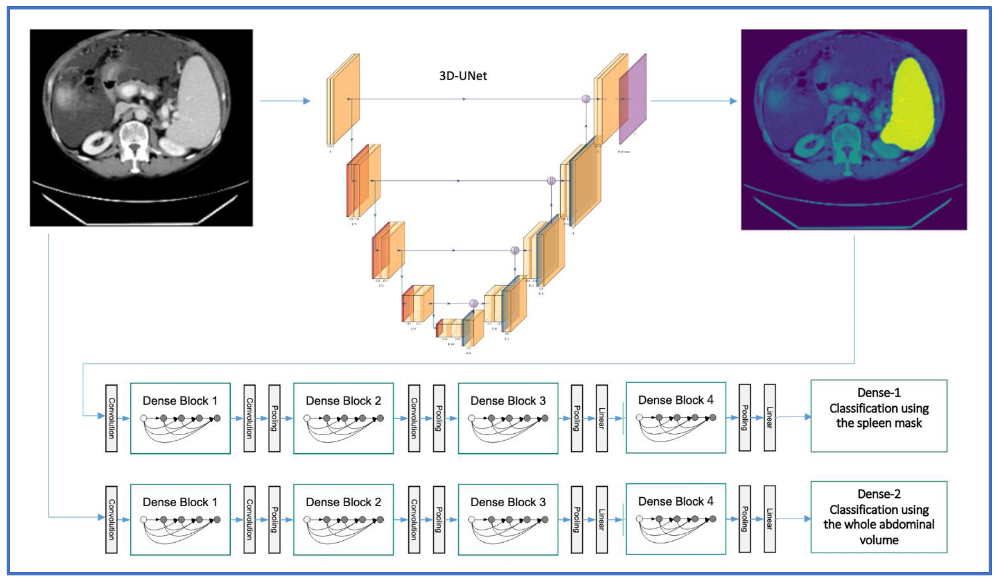


**Setup environment**

In [ ]:
%pip install -q monai==0.7.0
#%pip install "monai--weekly[nibabel, skimage, pillow, tensorboard, gdown, ignite, torchvision, itk, tqdm, lmdb, psutil]"

**Setup imports**

In [ ]:
1# Copyright 2020 MONAI Consortium
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#     http://www.apache.org/licenses/LICENSE-2.0
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

%pip install pandas
import logging
import os
import sys
import tempfile
import shutil
from PIL import Image
import matplotlib.pyplot as plt
import torch
from torch.utils.tensorboard import SummaryWriter
import numpy as np

import monai
from monai.networks.nets import DenseNet121, Classifier
from monai.apps import download_and_extract
from monai.config import print_config
from monai.utils import first
from monai.visualize import GradCAM
from monai.metrics import ConfusionMatrixMetric, get_confusion_matrix
from monai.data import CacheDataset, DataLoader, ImageDataset, ITKReader, PILReader, Dataset, partition_dataset_classes, partition_dataset
from sklearn.metrics import (
    classification_report, confusion_matrix,
    ConfusionMatrixDisplay, 
)
from monai.data import decollate_batch
from monai.metrics import ROCAUCMetric
from torch.utils.data import DataLoader 
from monai.transforms import Transform
from monai.transforms import (
    AddChannel,
    Compose,
    LoadImage,
    RandRotate90,
    Invertd,
    Lambda,
    Resize,
    Orientation,
    Orientationd,
    EnsureChannelFirstd,
    ScaleIntensity,
    AsChannelFirst,
    AsChannelLast,
    Activations,
    AddChannel,
    AddChanneld,
    ToTensord,
    Resized,
    AsDiscrete,
    Spacingd,
    EnsureChannelFirst,
    RepeatChannel,
    RemoveRepeatedChannel,
    ScaleIntensityRanged,
    SplitChannel,
    SqueezeDim,
    ToTensor,
    Randomizable,
    LoadImaged,
    ToTensord,
    MaskIntensityd,
    Flip,
    MaskIntensity,
    ScaleIntensityd,
    EnsureType,
    EnsureTyped,
)
import numpy as np
import statsmodels.formula.api as smf
import statsmodels.api as sm
import pandas as pd
import seaborn as sns 
from glob import glob
import logging
from abc import ABC, abstractmethod
from typing import Any, Callable, Dict, Generator, Hashable, Iterable, List, Optional, Tuple

import numpy as np
import torch
import matplotlib as mpl

import numpy as np
from monai.transforms import Transform, AddChannel, AsChannelFirst
from monai.networks.utils import eval_mode, train_mode
from monai.data.utils import pad_list_data_collate
from monai.visualize import GradCAM, GradCAMpp, OcclusionSensitivity

logging.basicConfig(stream=sys.stdout, level=logging.INFO)
print_config()

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
MONAI version: 0.7.0
Numpy version: 1.21.6
Pytorch version: 1.12.1+cu113
MONAI flags: HAS_EXT = False, USE_COMPILED = False
MONAI rev id: bfa054b9c3064628a21f4c35bbe3132964e91f43

Optional dependencies:
Pytorch Ignite version: NOT INSTALLED or UNKNOWN VERSION.
Nibabel version: 3.0.2
scikit-image version: 0.18.3
Pillow version: 7.1.2
Tensorboard version: 2.9.1
gdown version: 4.4.0
TorchVision version: 0.13.1+cu113
tqdm version: 4.64.1
lmdb version: 0.99
psutil version: 5.4.8
pandas version: 1.3.5
einops version: NOT INSTALLED or UNKNOWN VERSION.
transformers version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/latest/installation.html#installing-the-recommended-dependencies



**Data Direction**

In [ ]:
data_dir= "Spleen_AI"

In [ ]:
%pip install openpyxl==3.0.9
labels_all = pd.read_excel (r'/content/drive/MyDrive/Spleen_AI/labels.xlsx')
l=labels_all["label"].to_numpy()
print(l)
#print(labels_all["label"])

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 242 kB 14.0 MB/s 
  Attempting uninstall: openpyxl
    Found existing installation: openpyxl 3.0.10
    Uninstalling openpyxl-3.0.10:
      Successfully uninstalled openpyxl-3.0.10
[1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1
 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 1
 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1
 1 0 0 1 1 1 1 1 1 1 1 1 1]


In [ ]:
test_img = sorted(glob(os.path.join(data_dir, "validation/", "*.nii.gz")))
labels_val = pd.read_excel (r'/content/drive/MyDrive/Spleen_AI/val_label.xlsx')
test_label= labels_val["label"].to_numpy()
print(len(test_img))
print(len(test_label))

25
25


In [ ]:
images = sorted(glob(os.path.join(data_dir, "Projekt2/", "*.nii.gz")))
#segmentations = sorted(glob(os.path.join(data_dir, "Projekt2/segmentation/*", "*.nii.gz")))

#for i in images:
 # print(os.path.basename(i))

labels= l
#labels= np.array([0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1], dtype=np.int64)
print(len(images))
#print(len(segmentations))
print(len(labels))


124
124


**Check Data Shape**

In [ ]:
device = torch.device("cuda")
#AddChannel(), Orientation(axcodes="PRI"),Flip(spatial_axis=0),
transforms=Compose([ Flip(spatial_axis=(0,-1)), ToTensor()])
check = ImageDataset(image_files=images[:2], labels=labels[:2],
                        transform=transforms)
check_loader = DataLoader(check, batch_size=1,
                          num_workers=1, pin_memory=torch.cuda.is_available())
for data,i in check_loader:
  inputs = data[0].to(device)
  inputs = data[1].to(device)
  plt.imshow(data[0][:, :, 35], cmap="gray")
  plt.imshow(data[1][:, :, 35], cmap="gray")
  print(inputs.shape)

**Loading Data**

In [ ]:
#train_files = [{"image": i, "seg": s, "label": l} for i, s, l in zip(images[:100], segmentations[:100], labels[:100])]
#val_files  = [{"image": i, "seg": s, "label": l} for i, s, l in zip(images[100:], segmentations[100:], labels[100:])]

data = [{"image": i, "label": l} for i, l in zip(images, labels)]

transforms = Compose([
    LoadImaged(keys=["image"]),
    AddChanneld(keys=["image"]),
    #Spacingd(keys=["image"], pixdim=(1.5, 1.5, 2.0), mode=("bilinear", "nearest")),
    Orientationd(keys=["image"], axcodes="PLI"),
    Resized(keys=["image"], spatial_size=(120, 120, 120)),
    ScaleIntensityRanged(keys=['image'], a_min=-57, a_max=164, b_min=0.0, b_max=1.0, clip=True),
    #MaskIntensityd(keys="image", mask_key="seg"),
    EnsureTyped(keys=["image"]),
])
batch_size=4
divisible_factor = 2

ds = Dataset(data, transforms)
dl = DataLoader(
    ds,
    batch_size=batch_size,
    shuffle=True,
    num_workers=4,
    collate_fn=pad_list_data_collate,
    drop_last=True,
)

data_partition= partition_dataset_classes(data, labels.tolist(), shuffle=True, ratios=[0.8, 0.2])

# create a training data loader
train_ds = CacheDataset(data=data_partition[0], transform=transforms)
train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=torch.cuda.is_available())

# create a validation data loader
val_ds = CacheDataset(data=data_partition[1], transform=transforms)
val_loader = DataLoader(val_ds, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=torch.cuda.is_available())

post_pred = Compose([EnsureType(), Activations(softmax=True)])
post_label = Compose([EnsureType(), AsDiscrete(to_onehot=True, n_classes=2)])

Loading dataset: 100%|██████████| 25/25 [00:09<00:00,  2.51it/s]


In [ ]:
test_data = [{"vimage": vi, "vlabel": vl} for vi, vl in zip(test_img, test_label)]
transforms = Compose([
    LoadImaged(keys=["vimage"]),
    AddChanneld(keys=["vimage"]),
    #Spacingd(keys=["image"], pixdim=(1.5, 1.5, 2.0), mode=("bilinear", "nearest")),
    Orientationd(keys=["vimage"], axcodes="PLI"),
    Resized(keys=["vimage"], spatial_size=(120, 120, 120)),
    ScaleIntensityRanged(keys=['vimage'], a_min=-57, a_max=164, b_min=0.0, b_max=1.0, clip=True),
    #MaskIntensityd(keys="image", mask_key="seg"),
    EnsureTyped(keys=["vimage"]),
])
test_ds = CacheDataset(data=test_data, transform=transforms)
test_loader = DataLoader(test_ds, batch_size=4, shuffle=False, num_workers=4, pin_memory=torch.cuda.is_available())

Loading dataset: 100%|██████████| 25/25 [00:15<00:00,  1.59it/s]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


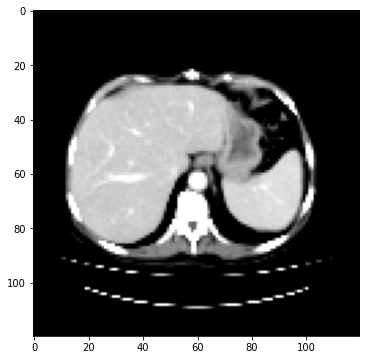

In [ ]:
device = torch.device("cuda")
for data in train_loader:
  image = data["image"].to(device) 
  plt.figure("check", (18, 6))
  plt.subplot(1, 2, 1)
  plt.imshow(data["image"][0, 0, :, :, 22], cmap="gray")
 

  #print(inputs.shape)

**Training**

In [ ]:
# Create DenseNet121, CrossEntropyLoss and Adam optimizer
device = torch.device("cuda")
from monai.networks.nets import  resnet34, resnet50
#model= resnet50(spatial_dims=3, pretrained=False, num_classes=2).to(device)

model = monai.networks.nets.DenseNet121(spatial_dims=3, in_channels=1, out_channels=2).to(device)
#model = monai.networks.nets.ResNet(block=('basic'), layers=3, block_inplanes=1, spatial_dims=3, n_input_channels=1, conv1_t_size=7, conv1_t_stride=1, no_max_pool=False, shortcut_type='B', widen_factor=1.0, num_classes=400, feed_forward=True).to(device)
loss_function = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), 1e-4)
auc_metric = ROCAUCMetric()

In [ ]:
# start a typical PyTorch training
val_interval = 2
best_metric = -1
best_metric_epoch = -1
epoch_loss_values = []
metric_values = []
acc_values = []
writer = SummaryWriter()
max_epochs = 100
for epoch in range(max_epochs):
        print("-" * 10)
        print(f"epoch {epoch + 1}/{max_epochs}")
        model.train()
        epoch_loss = 0
        step = 0
        for batch_data in train_loader:
            step += 1
            inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = loss_function(outputs, labels)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
            epoch_len = len(train_ds) // train_loader.batch_size
            print(f"{step}/{epoch_len}, train_loss: {loss.item():.4f}")
            writer.add_scalar("train_loss", loss.item(), epoch_len * epoch + step)
        epoch_loss /= step
        epoch_loss_values.append(epoch_loss)
        print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")

        if (epoch + 1) % val_interval == 0:
            model.eval()
            with torch.no_grad():
                y_pred = torch.tensor([], dtype=torch.float32, device=device)
                y = torch.tensor([], dtype=torch.long, device=device)
                for val_data in val_loader:
                    val_images, val_labels = val_data["image"].to(device), val_data["label"].to(device)
                    y_pred = torch.cat([y_pred, model(val_images)], dim=0)
                    y = torch.cat([y, val_labels], dim=0)

                acc_value = torch.eq(y_pred.argmax(dim=1), y)
                acc_metric = acc_value.sum().item() / len(acc_value)
                y_onehot = [post_label(i) for i in decollate_batch(y)]
                y_pred_act = [post_pred(i) for i in decollate_batch(y_pred)]
                auc_metric(y_pred_act, y_onehot)
                auc_result = auc_metric.aggregate()
                auc_metric.reset()
                del y_pred_act, y_onehot
                metric_values.append(auc_result)

                if acc_metric > best_metric:
                    best_metric = acc_metric
                    best_metric_epoch = epoch + 1
                    
                    torch.save(model.state_dict(), "/content/drive/My Drive/Spleen_AI/best_metric_model_classification3d_abd_final.pth")
                    print("saved new best metric model")
                print(
                    "current epoch: {} current accuracy: {:.4f} current AUC: {:.4f} best accuracy: {:.4f} at epoch {}".format(
                        epoch + 1, acc_metric, auc_result, best_metric, best_metric_epoch
                    )
                )
                writer.add_scalar("val_accuracy", acc_metric, epoch + 1)
print(f"train completed, best_metric: {best_metric:.4f} at epoch: {best_metric_epoch}")
writer.close()

----------
epoch 1/100
1/24, train_loss: 0.7226
2/24, train_loss: 0.4853
3/24, train_loss: 0.4926
4/24, train_loss: 0.5138
5/24, train_loss: 1.0619
6/24, train_loss: 1.0716
7/24, train_loss: 0.5930
8/24, train_loss: 0.6566
9/24, train_loss: 0.4335
10/24, train_loss: 0.5718
11/24, train_loss: 0.4482
12/24, train_loss: 1.0886
13/24, train_loss: 0.4723
14/24, train_loss: 0.9913
15/24, train_loss: 0.3895
16/24, train_loss: 0.5504
17/24, train_loss: 0.3898
18/24, train_loss: 0.4844
19/24, train_loss: 0.3646
20/24, train_loss: 0.4808
21/24, train_loss: 0.3683
22/24, train_loss: 0.2356
23/24, train_loss: 0.1829
24/24, train_loss: 0.9630
25/24, train_loss: 0.1913
epoch 1 average loss: 0.5682
----------
epoch 2/100
1/24, train_loss: 0.5511
2/24, train_loss: 0.4527
3/24, train_loss: 1.0816
4/24, train_loss: 0.1637
5/24, train_loss: 0.7834
6/24, train_loss: 0.6896
7/24, train_loss: 0.1908
8/24, train_loss: 0.9848
9/24, train_loss: 0.3770
10/24, train_loss: 0.3963
11/24, train_loss: 0.2263
12/24, 

KeyboardInterrupt: ignored

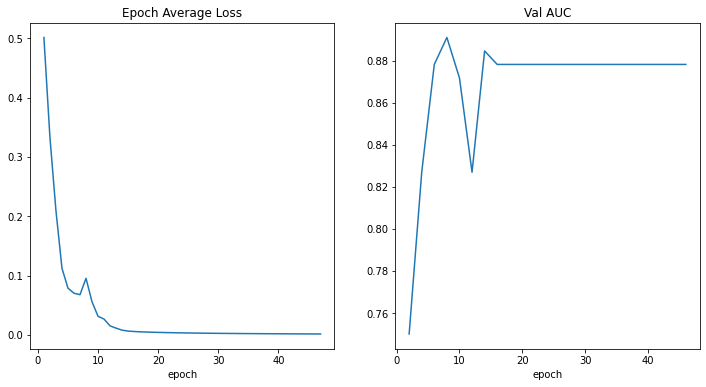

In [ ]:
plt.figure("train", (12, 6))
plt.subplot(1, 2, 1)
plt.title("Epoch Average Loss")
x = [i + 1 for i in range(len(epoch_loss_values))]
y = epoch_loss_values
plt.xlabel("epoch")
plt.plot(x, y)
plt.subplot(1, 2, 2)
plt.title("Val AUC")
x = [val_interval * (i + 1) for i in range(len(metric_values))]
y = metric_values
plt.xlabel("epoch")
plt.plot(x, y)

plt.show()

**Evaluation Metrics**

In [ ]:
from sklearn.metrics import (classification_report, confusion_matrix,ConfusionMatrixDisplay, roc_auc_score, balanced_accuracy_score)



                 precision    recall  f1-score   support

Liver_Cirrhosis       0.90      0.69      0.78        13
       Lymphoma       0.73      0.92      0.81        12

       accuracy                           0.80        25
      macro avg       0.82      0.80      0.80        25
   weighted avg       0.82      0.80      0.80        25

AUC = 0.8044871794871795


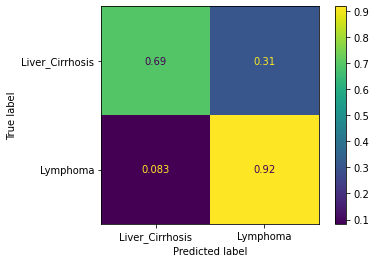

In [ ]:
from enum import Enum
from sklearn.metrics import (
    classification_report, confusion_matrix,
    ConfusionMatrixDisplay
)
class Diagnosis(Enum):
    Liver_Cirrhosis = 0
    Lymphoma = 1
    

%matplotlib inline
# Load best model
model.load_state_dict(torch.load("/content/drive/My Drive/Spleen_AI/best_metric_model_classification3d_abd_120.pth"))
model.to(device)
model.eval()

with torch.no_grad():
    y_pred = torch.tensor([], dtype=torch.float32, device=device)
    y = torch.tensor([], dtype=torch.long, device=device)

    for val_data in val_loader:
        val_images, val_labels = val_data["image"].to(
            device), val_data["label"].to(device),

        outputs = model(val_images)
        y_pred = torch.cat([y_pred, outputs.argmax(dim=1)], dim=0)
        y = torch.cat([y, val_labels], dim=0)
        #auc_metric.reset()
        auc_metric(y_pred, y)
        auc_result = auc_metric.aggregate()
        auc_metric.reset()
        

print(classification_report(
    y.cpu().numpy(),
    y_pred.cpu().numpy(),
    target_names=[d.name for d in Diagnosis]))

cm = confusion_matrix (
    y.cpu().numpy(),
    y_pred.cpu().numpy(),
    normalize='true',
)
cmm = ConfusionMatrixMetric (include_background=True, metric_name=["sensitivity","specificity","negative predictive value"])
print("AUC =",auc_result)

disp = ConfusionMatrixDisplay(
    confusion_matrix=cm,
    display_labels=[d.name for d in Diagnosis],
)
disp.plot(ax=plt.subplots(1, 1, facecolor='white')[1])

[0.72566998 0.50128412 0.02288019 0.02604055 0.25754324 0.2568
 0.15709344 0.01793884 0.04779188 0.9972614  0.85543555 0.08032602
 0.76937157 0.97555727 0.06019643 0.62134552 0.13124222 0.37892929
 0.73757195 0.62455308 0.10541618 0.57867748 0.84129828 0.70604378
 0.73850173]
[1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 1.
 1.]
[1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1.
 0.]


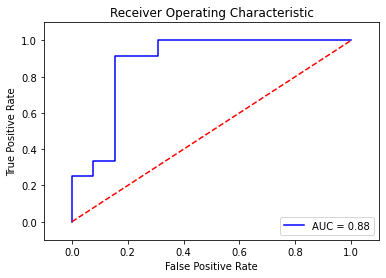

In [ ]:
#ROC-Curve from pretrained model
import sklearn.metrics as metrics
device = torch.device("cuda")
model = monai.networks.nets.DenseNet121(spatial_dims=3, in_channels=1, out_channels=2)
model.load_state_dict(torch.load("/content/drive/My Drive/Spleen_AI/best_metric_model_classification3d_abd_300.pth"))
model.to(device)
loss_function = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), 1e-4)
auc_metric = ROCAUCMetric()
#print(model)

orig_labels=np.array([])
prob_labels=np.array([])
pred_labels=np.array([])
with eval_mode(model):
    rand_data=val_ds

    for row, d in enumerate(rand_data):
        img = torch.as_tensor(d["image"])[None].to(device)
        val_outputs = model(img)
        prob = torch.nn.functional.softmax(val_outputs,dim=1)
        top_p, top_class = prob.topk(1, dim = 1)
        sigmoidScores = torch.sigmoid(val_outputs)
        sigma_vals=sigmoidScores.cpu().numpy().tolist()
        sigma_vals=np.array(sigma_vals).transpose()
        sigma_vals=sigma_vals[1]
        orig_val=(d['label'])
        pred_label = model(img).argmax(dim=1).item()
        pred_val=pred_label
        orig_labels=np.append(orig_labels,orig_val)
        pred_labels=np.append(pred_labels,pred_val)
        prob_labels=np.append(prob_labels,sigma_vals)

print(prob_labels)
print(pred_labels)
print(orig_labels)
fpr, tpr, threshold = metrics.roc_curve(orig_labels, prob_labels,pos_label=1)
roc_auc = metrics.auc(fpr, tpr)

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([-0.1, 1.1])
plt.ylim([-0.1, 1.1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()



In [ ]:
from sklearn.metrics import (roc_auc_score, balanced_accuracy_score)
results_label1= np.array([0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0])
bas=balanced_accuracy_score(y.cpu().numpy(),y_pred.cpu().numpy())
print('BAS:',bas)
best_auc= auc_result
print('ROCAUC:',best_auc)
sensitivity= cm[0][0]
specificity= cm[1][1]
print('Sensitivität:',sensitivity)
print('Spezifität:',specificity)

BAS: 0.8044871794871795
ROCAUC: 0.8044871794871795
Sensitivität: 0.6923076923076923
Spezifität: 0.9166666666666666


**Gradcam**

Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.33it/s]


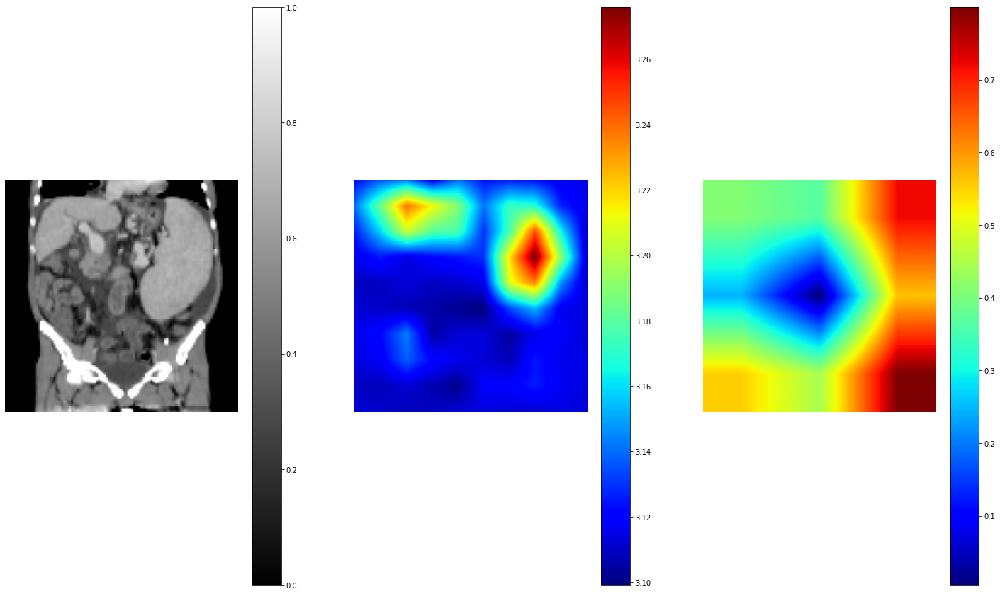

In [ ]:
itera = iter(test_loader)
def get_next_im():
    test_data = next(itera)
    return test_data["vimage"].to(device), test_data["vlabel"].unsqueeze(0).to(device)
# Get a random image and its corresponding label
img, label = get_next_im()
img = img.transpose(-1,-2)
# Get the occlusion sensitivity map
occ_sens = monai.visualize.OcclusionSensitivity(
    nn_module=model, mask_size=12, n_batch=10, stride=12)
# Get the CAM
cam = monai.visualize.GradCAM(
    nn_module=model, target_layers="class_layers.relu"
)
# Only get a single slice to save time.
# For the other dimensions (channel, width, height), use
# -1 to use 0 and img.shape[x]-1 for min and max, respectively
depth_slice = img.shape[2] // 2

occ_sens_b_box = [-1, -1, depth_slice, depth_slice, -1, -1, -1, -1]

occ_result, _ = occ_sens(x=img, b_box=occ_sens_b_box)
occ_result = occ_result[..., label.item()]
#occ_result = occ_result.transpose(-1,-2)
cam_result = cam(x=img, class_idx=None)
cam_result = cam_result[..., depth_slice]


fig, axes = plt.subplots(1, 3, figsize=(25, 15), facecolor='white')

for i, im in enumerate([img[:,:, depth_slice, ...], occ_result, cam_result]):
    cmap = 'gray' if i == 0 else 'jet'
    ax = axes[i]
    if isinstance(im, torch.Tensor):
        im = im.cpu().detach()    
    #im_show = ax.imshow(im[0][0], cmap=cmap)
    im_show = ax.imshow(np.squeeze(im[0][0]), cmap=cmap)
    ax.axis('off')
    fig.colorbar(im_show, ax=ax)



Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.17it/s]


---------
ID: 12555575
Orig: Lymphoma
Pred: Lymphoma
0 0
0 1
0 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 12633486
Orig: Lymphoma
Pred: Lymphoma
1 0
1 1
1 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.80it/s]


---------
ID: 12656178
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
2 0
2 1
2 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12692451
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
3 0
3 1
3 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12697165
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
4 0
4 1
4 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.62it/s]


---------
ID: 12706474
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
5 0
5 1
5 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.60it/s]


---------
ID: 12706553
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
6 0
6 1
6 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 12706591
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
7 0
7 1
7 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.71it/s]


---------
ID: 12708363
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
8 0
8 1
8 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12714971
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
9 0
9 1
9 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.72it/s]


---------
ID: 12728166
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
10 0
10 1
10 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 12734777
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
11 0
11 1
11 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.73it/s]


---------
ID: 12737076
Orig: Lymphoma
Pred: Lymphoma
12 0
12 1
12 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12738318
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
13 0
13 1
13 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 12744614
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
14 0
14 1
14 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.71it/s]


---------
ID: 12746064
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
15 0
15 1
15 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12746503
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
16 0
16 1
16 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12750465
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
17 0
17 1
17 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 12750630
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
18 0
18 1
18 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 12751741
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
19 0
19 1
19 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 12751960
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
20 0
20 1
20 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.61it/s]


---------
ID: 12752087
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
21 0
21 1
21 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12759666
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
22 0
22 1
22 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12760068
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
23 0
23 1
23 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12761363
Orig: Lymphoma
Pred: Lymphoma
24 0
24 1
24 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.69it/s]


---------
ID: 12762874
Orig: Liver_Cirrhosis
Pred: Lymphoma
25 0
25 1
25 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.61it/s]


---------
ID: 12764157
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
26 0
26 1
26 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.69it/s]


---------
ID: 12771584
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
27 0
27 1
27 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 12784071
Orig: Lymphoma
Pred: Lymphoma
28 0
28 1
28 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.62it/s]


---------
ID: 12786322
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
29 0
29 1
29 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.73it/s]


---------
ID: 12789405
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
30 0
30 1
30 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.73it/s]


---------
ID: 12791782
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
31 0
31 1
31 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.62it/s]


---------
ID: 12792555
Orig: Lymphoma
Pred: Lymphoma
32 0
32 1
32 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12794443
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
33 0
33 1
33 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.61it/s]


---------
ID: 12796110
Orig: Lymphoma
Pred: Lymphoma
34 0
34 1
34 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12796691
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
35 0
35 1
35 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12796758
Orig: Lymphoma
Pred: Lymphoma
36 0
36 1
36 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 12799081
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
37 0
37 1
37 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.72it/s]


---------
ID: 12799967
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
38 0
38 1
38 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12802453
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
39 0
39 1
39 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.70it/s]


---------
ID: 12808742
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
40 0
40 1
40 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 12809223
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
41 0
41 1
41 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 12816888
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
42 0
42 1
42 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12823723
Orig: Lymphoma
Pred: Lymphoma
43 0
43 1
43 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12824762
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
44 0
44 1
44 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12832085
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
45 0
45 1
45 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12833610
Orig: Lymphoma
Pred: Lymphoma
46 0
46 1
46 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.74it/s]


---------
ID: 12835934
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
47 0
47 1
47 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.61it/s]


---------
ID: 12837809
Orig: Lymphoma
Pred: Lymphoma
48 0
48 1
48 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.62it/s]


---------
ID: 12840167
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
49 0
49 1
49 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.70it/s]


---------
ID: 12843006
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
50 0
50 1
50 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 12843024
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
51 0
51 1
51 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 12843074
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
52 0
52 1
52 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 12849078
Orig: Lymphoma
Pred: Lymphoma
53 0
53 1
53 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.70it/s]


---------
ID: 12849216
Orig: Lymphoma
Pred: Lymphoma
54 0
54 1
54 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 12855875
Orig: Lymphoma
Pred: Lymphoma
55 0
55 1
55 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 12864267
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
56 0
56 1
56 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.72it/s]


---------
ID: 12872731
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
57 0
57 1
57 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 12879137
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
58 0
58 1
58 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12884513
Orig: Lymphoma
Pred: Lymphoma
59 0
59 1
59 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.80it/s]


---------
ID: 12890896
Orig: Lymphoma
Pred: Lymphoma
60 0
60 1
60 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.73it/s]


---------
ID: 12893877
Orig: Lymphoma
Pred: Lymphoma
61 0
61 1
61 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.72it/s]


---------
ID: 12896765
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
62 0
62 1
62 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 12906945
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
63 0
63 1
63 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 12910237
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
64 0
64 1
64 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12913169
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
65 0
65 1
65 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 12925578
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
66 0
66 1
66 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 12936749
Orig: Liver_Cirrhosis
Pred: Lymphoma
67 0
67 1
67 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 12946298
Orig: Lymphoma
Pred: Lymphoma
68 0
68 1
68 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 12947582
Orig: Lymphoma
Pred: Lymphoma
69 0
69 1
69 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.73it/s]


---------
ID: 12948600
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
70 0
70 1
70 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 12961715
Orig: Lymphoma
Pred: Lymphoma
71 0
71 1
71 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.70it/s]


---------
ID: 12991076
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
72 0
72 1
72 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.71it/s]


---------
ID: 12993233
Orig: Lymphoma
Pred: Lymphoma
73 0
73 1
73 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.70it/s]


---------
ID: 12995453
Orig: Lymphoma
Pred: Lymphoma
74 0
74 1
74 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.61it/s]


---------
ID: 13000218
Orig: Lymphoma
Pred: Lymphoma
75 0
75 1
75 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 13017255
Orig: Lymphoma
Pred: Lymphoma
76 0
76 1
76 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.72it/s]


---------
ID: 13025709
Orig: Lymphoma
Pred: Lymphoma
77 0
77 1
77 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.69it/s]


---------
ID: 13029216
Orig: Lymphoma
Pred: Lymphoma
78 0
78 1
78 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 13035105
Orig: Lymphoma
Pred: Lymphoma
79 0
79 1
79 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 13043725
Orig: Lymphoma
Pred: Lymphoma
80 0
80 1
80 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 13051352
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
81 0
81 1
81 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.71it/s]


---------
ID: 13052166
Orig: Lymphoma
Pred: Lymphoma
82 0
82 1
82 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 13057491
Orig: Lymphoma
Pred: Lymphoma
83 0
83 1
83 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 13064461
Orig: Lymphoma
Pred: Lymphoma
84 0
84 1
84 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.74it/s]


---------
ID: 13067854
Orig: Lymphoma
Pred: Lymphoma
85 0
85 1
85 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 13071871
Orig: Lymphoma
Pred: Lymphoma
86 0
86 1
86 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.69it/s]


---------
ID: 13072433
Orig: Lymphoma
Pred: Lymphoma
87 0
87 1
87 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 13072652
Orig: Lymphoma
Pred: Lymphoma
88 0
88 1
88 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 13074632
Orig: Lymphoma
Pred: Lymphoma
89 0
89 1
89 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.60it/s]


---------
ID: 13074739
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
90 0
90 1
90 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 13092400
Orig: Lymphoma
Pred: Lymphoma
91 0
91 1
91 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.73it/s]


---------
ID: 13094782
Orig: Lymphoma
Pred: Lymphoma
92 0
92 1
92 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 13098259
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
93 0
93 1
93 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 13098775
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
94 0
94 1
94 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 13102422
Orig: Lymphoma
Pred: Lymphoma
95 0
95 1
95 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 13102816
Orig: Lymphoma
Pred: Lymphoma
96 0
96 1
96 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 13108576
Orig: Lymphoma
Pred: Lymphoma
97 0
97 1
97 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.72it/s]


---------
ID: 13108879
Orig: Lymphoma
Pred: Lymphoma
98 0
98 1
98 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.63it/s]


---------
ID: 13109120
Orig: Lymphoma
Pred: Lymphoma
99 0
99 1
99 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.73it/s]


---------
ID: 13109842
Orig: Lymphoma
Pred: Lymphoma
100 0
100 1
100 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 13111969
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
101 0
101 1
101 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 13113786
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
102 0
102 1
102 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.70it/s]


---------
ID: 13114149
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
103 0
103 1
103 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.61it/s]


---------
ID: 13123238
Orig: Lymphoma
Pred: Lymphoma
104 0
104 1
104 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.72it/s]


---------
ID: 13123452
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
105 0
105 1
105 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 13130088
Orig: Lymphoma
Pred: Lymphoma
106 0
106 1
106 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.69it/s]


---------
ID: 13130292
Orig: Lymphoma
Pred: Lymphoma
107 0
107 1
107 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 13131365
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
108 0
108 1
108 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.69it/s]


---------
ID: 13131475
Orig: Lymphoma
Pred: Lymphoma
109 0
109 1
109 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 13134001
Orig: Lymphoma
Pred: Lymphoma
110 0
110 1
110 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.70it/s]


---------
ID: 13135868
Orig: Lymphoma
Pred: Lymphoma
111 0
111 1
111 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.60it/s]


---------
ID: 13138755
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
112 0
112 1
112 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.67it/s]


---------
ID: 13151250
Orig: Liver_Cirrhosis
Pred: Liver_Cirrhosis
113 0
113 1
113 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.69it/s]


---------
ID: 13151781
Orig: Lymphoma
Pred: Lymphoma
114 0
114 1
114 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 13154242
Orig: Lymphoma
Pred: Lymphoma
115 0
115 1
115 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 13155618
Orig: Lymphoma
Pred: Lymphoma
116 0
116 1
116 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 13166298
Orig: Lymphoma
Pred: Liver_Cirrhosis
117 0
117 1
117 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 60.01it/s]


---------
ID: 13166424
Orig: Lymphoma
Pred: Lymphoma
118 0
118 1
118 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.68it/s]


---------
ID: 13196467
Orig: Lymphoma
Pred: Lymphoma
119 0
119 1
119 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.62it/s]


---------
ID: 13206640
Orig: Lymphoma
Pred: Lymphoma
120 0
120 1
120 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.66it/s]


---------
ID: 13225356
Orig: Lymphoma
Pred: Lymphoma
121 0
121 1
121 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.65it/s]


---------
ID: 13229161
Orig: Lymphoma
Pred: Lymphoma
122 0
122 1
122 2


Computing occlusion sensitivity: 100%|██████████| 100/100 [00:01<00:00, 59.64it/s]


---------
ID: 13235081
Orig: Lymphoma
Pred: Lymphoma
123 0
123 1
123 2


NameError: ignored

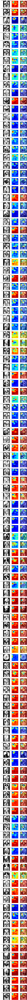

In [ ]:
occ_sens = OcclusionSensitivity(model, mask_size=50, n_batch=batch_size, stride=divisible_factor)
target_layer = "class_layers.relu"
gradcam = GradCAM(model, target_layers=target_layer)
gradcampp = GradCAMpp(model, target_layers=target_layer)


with eval_mode(model):
    num_examples = len(ds)
    num_cols=3 #4
    #rand_data = np.random.choice(ds, replace=False, size=num_examples)
    rand_data=ds
    subplot_shape = [num_examples, num_cols]
    figsize = [i * 5 for i in subplot_shape][::-1]
    fig, axes = plt.subplots(*subplot_shape, figsize=figsize, facecolor='white')


    #rand_data=ds
    for row, d in enumerate(rand_data):
        img = torch.as_tensor(d["image"])[None].to(device)
        label = torch.as_tensor(d["label"])[None].to(device)
        img_np=img.cpu().numpy()
        img_np=img_np[0][0][:][60][:]
        img_np=np.fliplr(img_np)
        img_np=np.rot90(img_np,k=1)
        #print(img_np)
        minval=np.percentile(img_np,0)
        maxval=np.percentile(img_np,80)
        pixvals=np.clip(img_np,minval,maxval)
        pixvals = ((pixvals-minval) /(maxval-minval))*255
        #print(pixvals)
        #plt.imshow(img_np, cmap="gray")

        filename=d['image_meta_dict']['filename_or_obj']
        name_short = filename.replace("/content/drive/My Drive/Spleen_AI/Projekt2/", "")
        name_short = name_short.replace(".nii.gz", "")

        # Get the occlusion sensitivity map
        occ_sens = monai.visualize.OcclusionSensitivity(
        nn_module=model, mask_size=12, n_batch=10, stride=12)


        depth_slice = img.shape[2] // 2

        occ_sens_b_box = [-1, -1, depth_slice, depth_slice, -1, -1, -1, -1]

        occ_result, _ = occ_sens(x=img, b_box=occ_sens_b_box)
        occ_result = occ_result[..., label.item()]
        occ_result=occ_result.cpu().detach()
        label = d["label"]
        orig_label=Diagnosis(d['label']).name
        pred_label = model(img).argmax(dim=1).item()
        pred_name=Diagnosis(pred_label).name

        print('---------')
        print('ID:',name_short)
        print('Orig:',orig_label)
        print('Pred:',pred_name)

        

        with train_mode(model):
            res_cam_pp = gradcampp(x=img, class_idx=pred_label)[0]
            

        # Occlusion sensitivity images
        #occ_map = occ_sens(img)[0][0]
        #occ_np=np.array(occ_map) 
        gc_img_np=np.squeeze(occ_result[0][0])
        gc_img_np=gc_img_np[:][:]
        #print(len(gc_img_np))
        #print(len(gc_img_np[0]))
        #print(gc_img_np)


        #gc_img_np=res_cam_pp
        #gc_img_np=np.array(gc_img_np.cpu())
        #gc_img_np=gc_img_np[0]
        #print(len(gc_img_np),len(gc_img_np[0]))
        #print(len(img_np),len(img_np[0]))
           

        for col in range(num_cols):
            ax = axes[row, col]
            print(row,col)

            if col==0:
              ax.imshow(pixvals, interpolation='none', cmap="gray")
              ax.set_title(f"ID:"+ name_short+ " Orig:"+ orig_label+ " Pred:"+ pred_name,fontsize=16)
              ax.axis('off')

            if col==1:
              ax.imshow(gc_img_np,cmap='jet')

              ax.axis('off') 

            if col==2:
              ax.imshow(pixvals, cmap="gray",alpha=1)
              ax.imshow(gc_img_np, interpolation='none', cmap='jet',alpha=0.5)
              ax.axis('off') 

            if col==3:
              ax.imshow(pixvals, cmap="gray",alpha=1)
              cmap = mpl.cm.get_cmap("autumn")
              cmap.set_over(color='black',alpha = 0.02)
              #ax.imshow(gc_img_np,cmap=cmap,vmax=np.max(gc_img_np)*0.66,alpha=0.66)
              #ax.imshow(gc_img_np, interpolation='none', cmap='autmn',alpha=0.7)
              ax.axis('off')

    plt.savefig("/content/drive/My Drive/Spleen_AI/Projekt2/Spleen_Results.png")


image_1 = Image.open(r'/content/drive/My Drive/Spleen_AI/Projekt2/Spleen_Results.png')
im_1 = image_1.convert('RGB')
im_1.save(r'/content/drive/My Drive/Spleen_AI/Projekt2/Spleen_Results.pdf')
files.download("/content/drive/My Drive/Spleen_AI/Projekt2/Spleen_Results.png")
files.download("/content/drive/My Drive/Spleen_AI/Projekt2/Spleen_Results.pdf")

tensor(0, device='cuda:0')


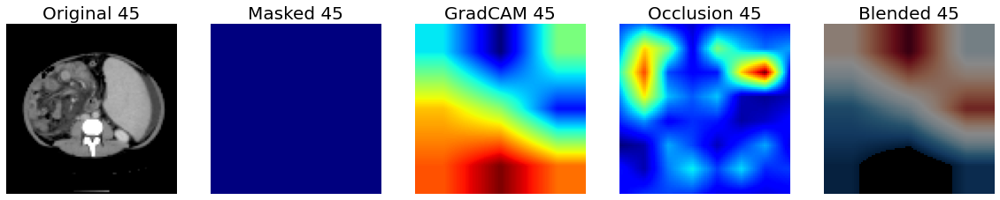

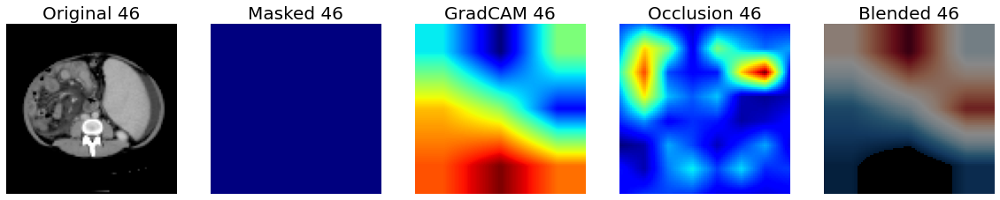

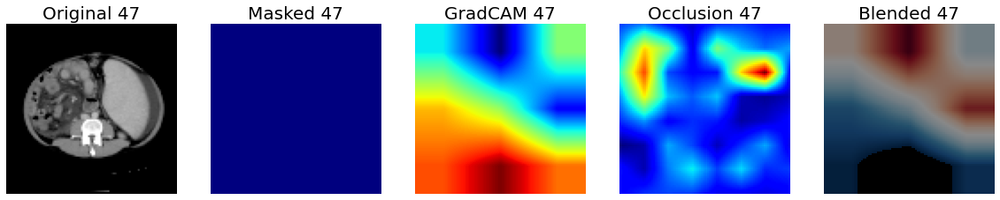

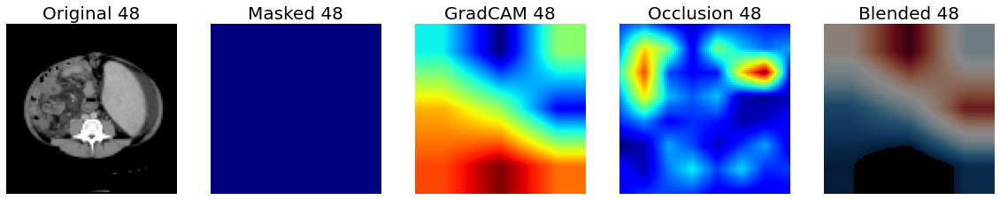

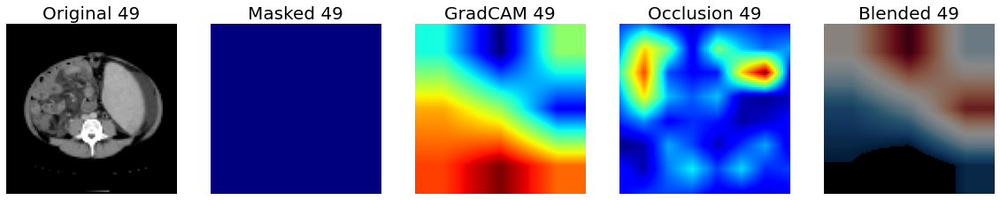

...

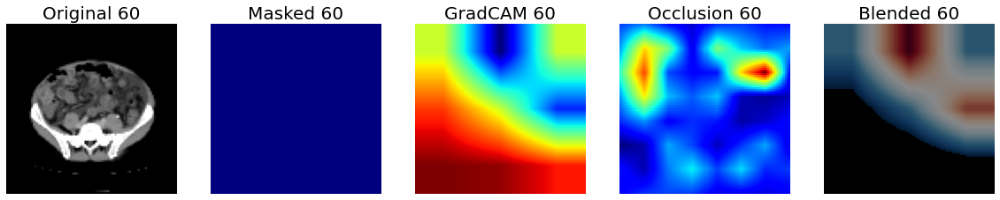

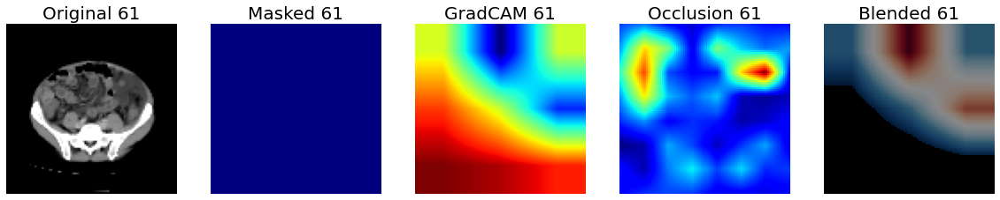

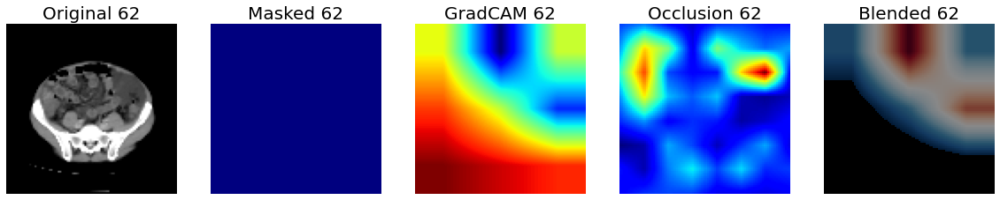

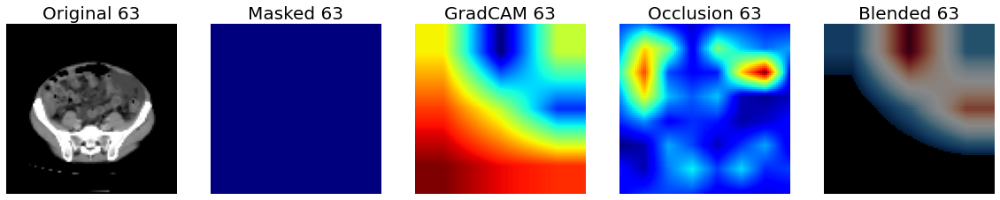

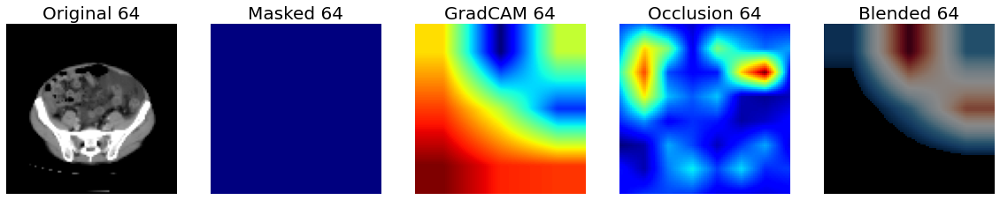

In [ ]:
from monai.visualize import blend_images, matshow3d, plot_2d_or_3d_image
import matplotlib as mpl
ret = blend_images(image=img, label=cam_result, alpha=1, cmap="hsv", rescale_arrays=False)
print(label[0,0])

for i in range(45, 65):
    slice_index = 1 * i
    img_np=np.array(img[0, 0, :, :, slice_index].cpu().detach())
    cam_np=np.array(cam_result[0, 0, :, :, slice_index].cpu().detach())
    cam_np=cam_np/(np.max(cam_np))
    occ_np=np.array(occ_result[0][0][0].cpu().detach())
    occ_np=occ_np- np.min(occ_np)
    occ_np = occ_np/np.max(occ_np)
    #print(img_np)
    #print(cam_np)
    #print(occ_np)

    plt.figure("blend image and label", (20, 4))

    plt.subplot(1, 5, 1)
    plt.title(f"Original {slice_index}", fontsize=20)
    plt.imshow(img_np, cmap="gray")
    plt.axis('off')  

    plt.subplot(1, 5, 2)
    plt.title(f"Masked {slice_index}", fontsize=20)
    cmap = mpl.cm.get_cmap("jet")
    cmap.set_under(color='black')
    plt.imshow(img_np, interpolation='none', cmap=cmap,vmin=np.min(img_np)+1)
    plt.axis('off')  

    plt.subplot(1, 5, 3)
    plt.title(f"GradCAM {slice_index}", fontsize=20)
    cmap = mpl.cm.get_cmap("jet")
    plt.imshow(cam_np,cmap=cmap)
    plt.axis('off')  


    plt.subplot(1, 5, 4)
    plt.title(f"Occlusion {slice_index}", fontsize=20)
    plt.imshow(occ_np, interpolation='none', cmap=cmap)
    plt.axis('off')  

    plt.subplot(1, 5, 5)
    plt.title(f"Blended {slice_index}", fontsize=20)
    cmap = mpl.cm.get_cmap("RdBu")
    cmap.set_over(color='black')
    plt.imshow(cam_np, interpolation='none', cmap=cmap, vmax=np.max(cam_np)*0.85,alpha=1)
    cmap = mpl.cm.get_cmap("RdBu")
    cmap.set_over(color='black')
    #plt.imshow(occ_np,cmap=cmap,vmax=np.max(occ_np)*0.85,alpha=1)
    cmap = mpl.cm.get_cmap("gray")
    cmap.set_under(color='black')
    plt.imshow(img_np, interpolation='none', cmap=cmap, vmin=np.min(img_np)+1,alpha=0.45)
    #plt.imshow(torch.moveaxis(ret[0, 0, :, :, slice_index].cpu().detach(),1,1),cmap=cmap,vmin=1)

    plt.axis('off')  
    plt.show()